In [1]:
%matplotlib inline

from tools import HOGFeatures
import glob
import cv2
import numpy as np
import pickle
from tools import draw_windows, get_hog_features, draw_labeled_bboxes, get_heatmap, find_bounding_boxes, y_limits
from matplotlib import pyplot as plt
from scipy.ndimage.measurements import label

In [2]:
clf = pickle.load(open("classifier.pkl", "rb"))

/home/ilya/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)
/home/ilya/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


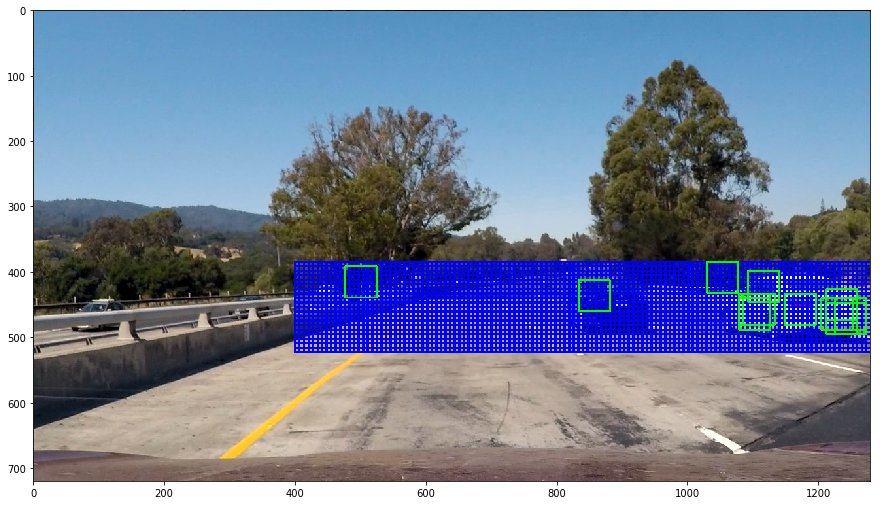

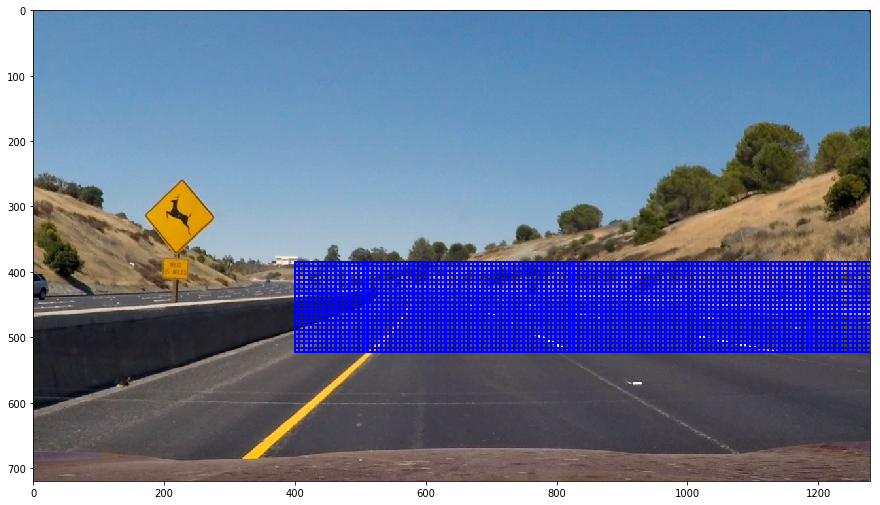

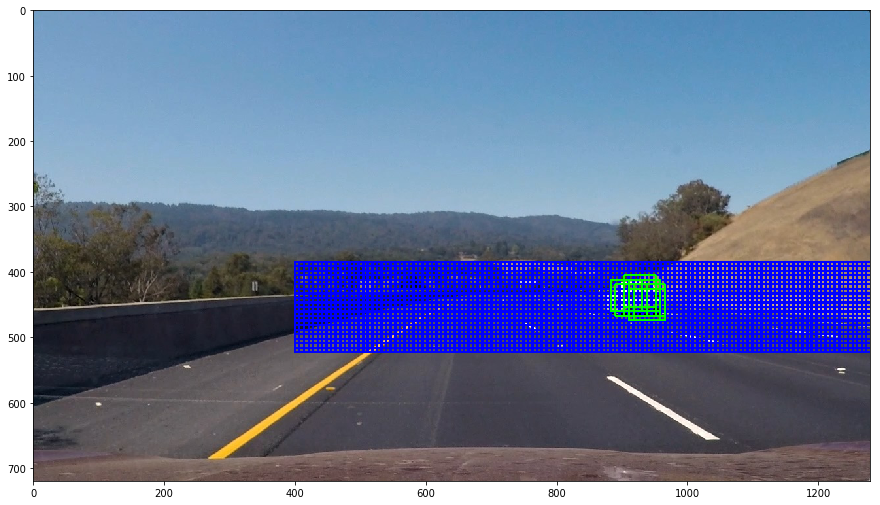

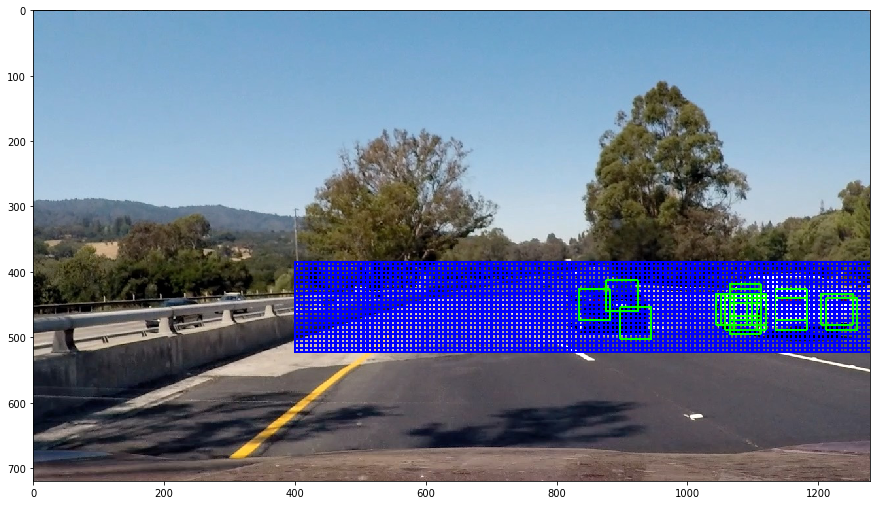

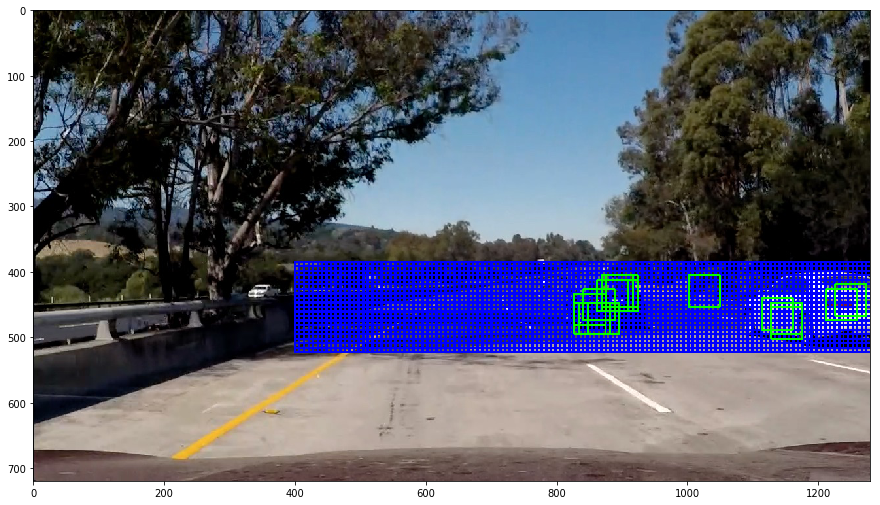

...

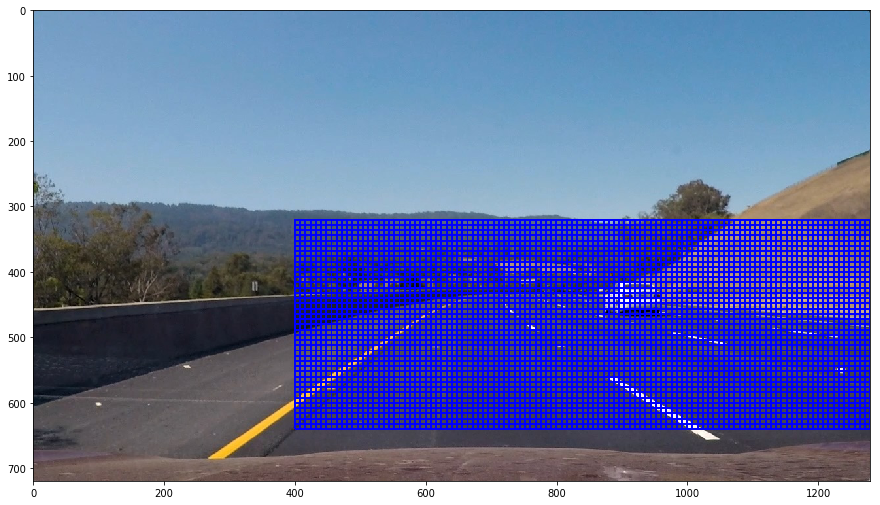

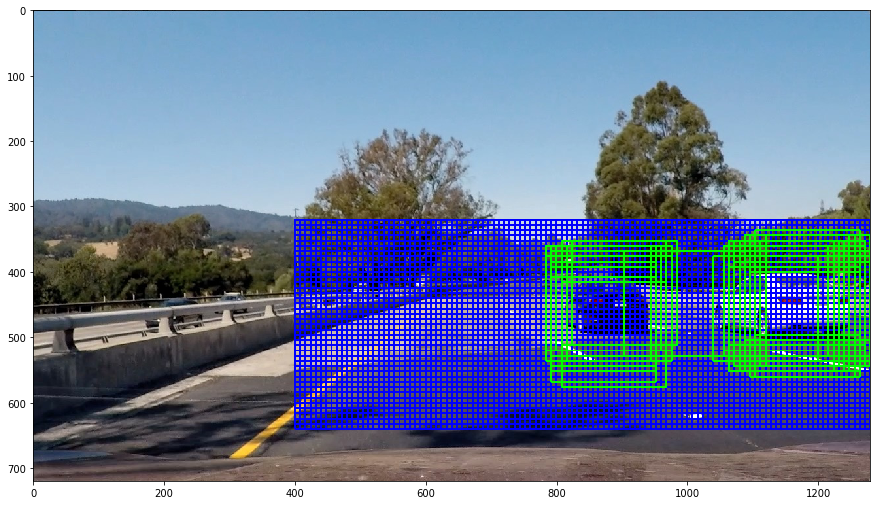

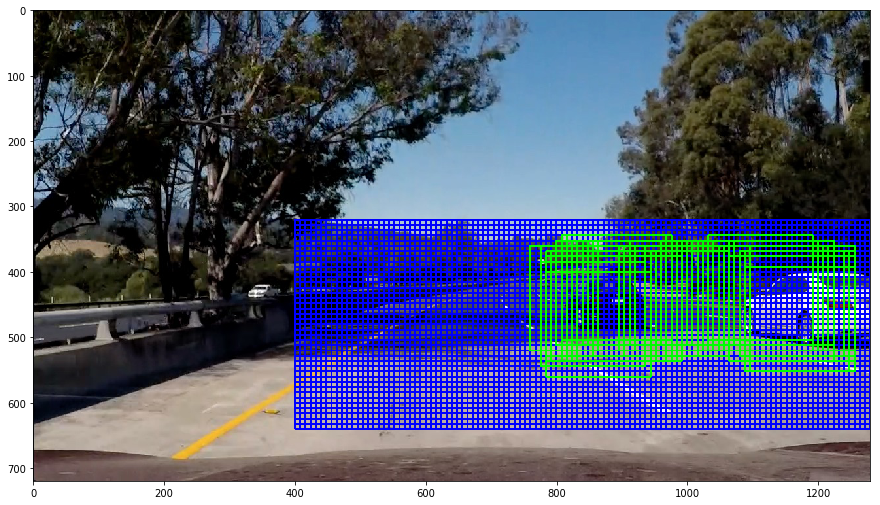

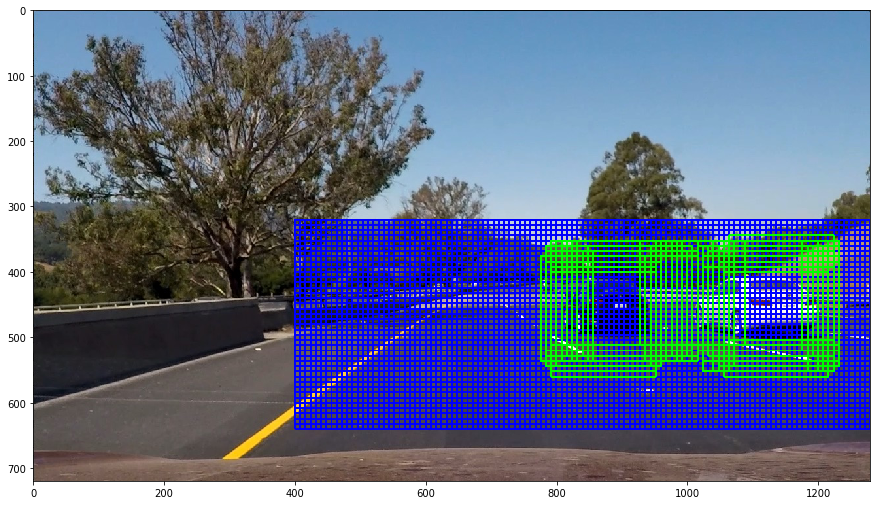

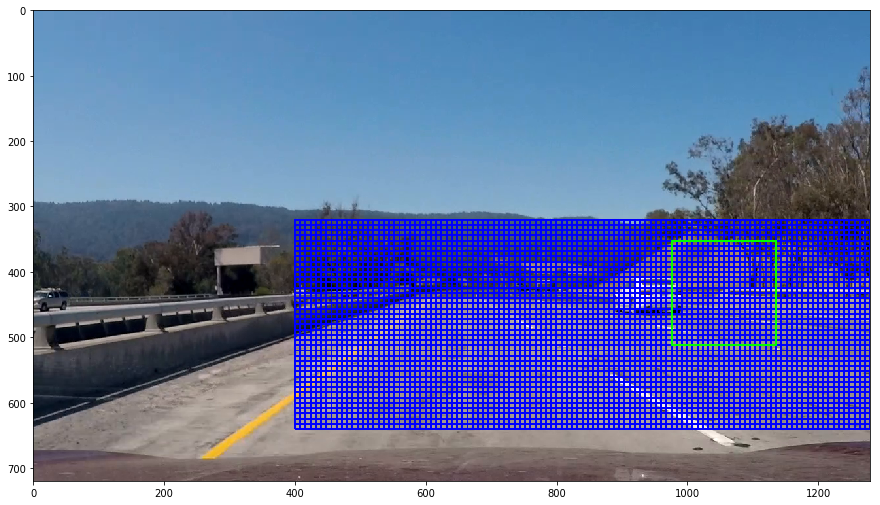

In [3]:
# Define a function that takes an image,
# start and stop positions in both x and y, 
# window size (x and y dimensions),  
# and overlap fraction (for both x and y)
def slide_window(img, x_start_stop=[None, None], y_start_stop=[None, None], 
                    xy_window=(64, 64), xy_overlap=(0.5, 0.5)):
    overlap = 1 - 8 / xy_window[0]
    xy_overlap = (overlap, overlap)
    
    # If x and/or y start/stop positions not defined, set to image size
    if x_start_stop[0] == None:
        x_start_stop[0] = 0
    if x_start_stop[1] == None:
        x_start_stop[1] = img.shape[1]
    if y_start_stop[0] == None:
        y_start_stop[0] = 0
    if y_start_stop[1] == None:
        y_start_stop[1] = img.shape[0]
    # Compute the span of the region to be searched    
    xspan = x_start_stop[1] - x_start_stop[0]
    yspan = y_start_stop[1] - y_start_stop[0]
    # Compute the number of pixels per step in x/y
    nx_pix_per_step = np.int(xy_window[0]*(1 - xy_overlap[0]))
    ny_pix_per_step = np.int(xy_window[1]*(1 - xy_overlap[1]))
    # Compute the number of windows in x/y
    nx_buffer = np.int(xy_window[0]*(xy_overlap[0]))
    ny_buffer = np.int(xy_window[1]*(xy_overlap[1]))
    nx_windows = np.int((xspan-nx_buffer)/nx_pix_per_step) 
    ny_windows = np.int((yspan-ny_buffer)/ny_pix_per_step) 
    # Initialize a list to append window positions to
    window_list = []
    # Loop through finding x and y window positions
    # Note: you could vectorize this step, but in practice
    # you'll be considering windows one by one with your
    # classifier, so looping makes sense
    for ys in range(ny_windows):
        for xs in range(nx_windows):
            # Calculate window position
            startx = xs*nx_pix_per_step + x_start_stop[0]
            endx = startx + xy_window[0]
            starty = ys*ny_pix_per_step + y_start_stop[0]
            endy = starty + xy_window[1]
            # Append window position to list
            window_list.append(((startx, starty), (endx, endy)))
    # Return the list of windows
    return window_list

images = [cv2.imread(path)[..., ::-1] for path in sorted(glob.glob("test_images/*"))]

img_good_windows = [list() for i in range(len(images))]

for window_size in [48, 64, 96, 128, 160]:
    for i, img in enumerate(images):
        windows = slide_window(
            img, 
            xy_window = (window_size, window_size),
            x_start_stop = [400, None],
            y_start_stop = y_limits[window_size]
        )

        clf_input = [(
            cv2.resize(img[starty:endy, startx:endx, :], (64, 64)), 
            np.array([], dtype=np.float64)
        ) for ((startx, starty), (endx, endy)) in windows]
        
        clf_input = HOGFeatures(color_space="YUV", cell_per_block=3, orient=9).transform(clf_input)
        
        prediction = clf.predict_proba(clf_input)
        good_windows = [windows[i] for i in np.nonzero(prediction[:, 1] > 0.5)[0]]
        bad_windows = [windows[i] for i in np.nonzero(prediction[:, 1] < 0.5)[0]]

        img_good_windows[i].extend(good_windows)
        
        img_boxes = draw_windows(img, windows, color=(0, 0, 255), thick=2)
        img_boxes = draw_windows(img_boxes, good_windows, color=(0, 255, 0), thick=2)

        plt.figure(figsize=(15, 9))
        plt.imshow(img_boxes)


/home/ilya/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/skimage/feature/_hog.py:119: skimage_deprecation: Default value of `block_norm`==`L1` is deprecated and will be changed to `L2-Hys` in v0.15
  'be changed to `L2-Hys` in v0.15', skimage_deprecation)


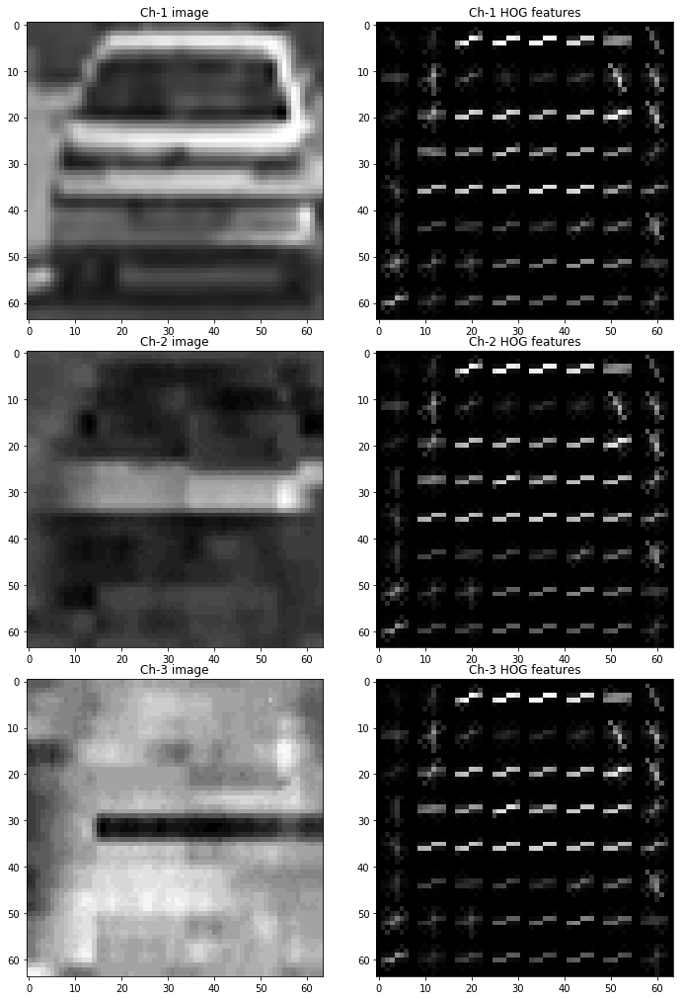

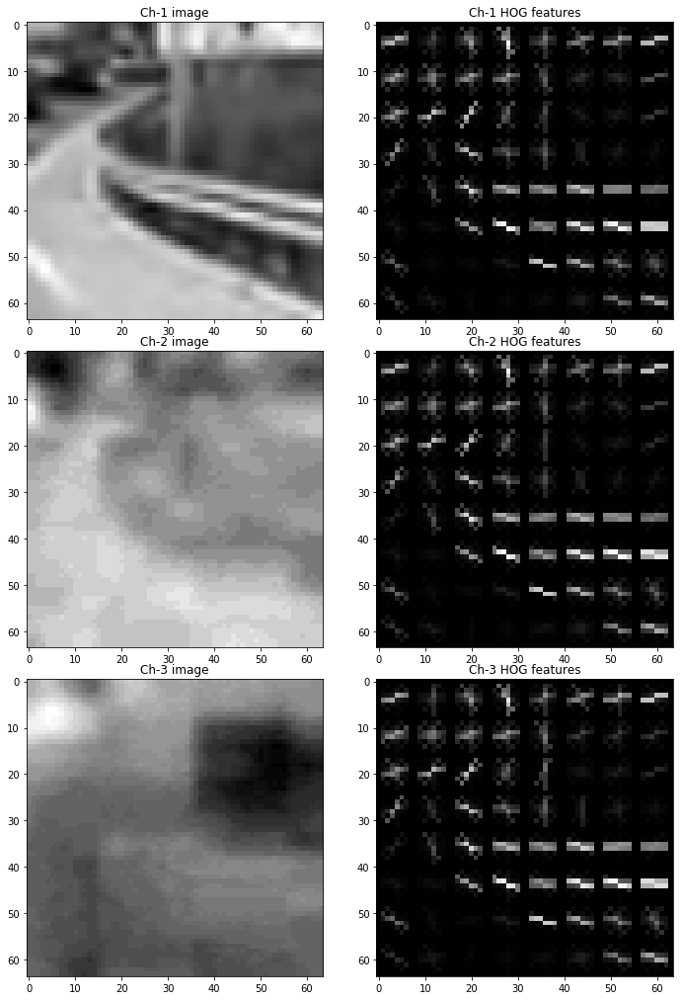

In [4]:
for car_image_path in ["vehicles/GTI_Far/image0307.png", "non-vehicles/GTI/image139.png"]:
    car_image = cv2.imread(car_image_path)[..., ::-1]
    yuv = cv2.cvtColor(car_image, cv2.COLOR_RGB2YUV)
    
    hog = []
    for i in range(3):
        hog.append(get_hog_features(car_image[..., i], orient=9, pix_per_cell=8, cell_per_block=2, vis=True)[1])
    
    fig, axs = plt.subplots(3, 2, figsize=(10, 14))
    fig.tight_layout()
    for i in range(3):
        axs[i, 0].set_title("Ch-%d image" % (i+1,))
        axs[i, 0].imshow(yuv[..., i], cmap="gray")
        axs[i, 1].set_title("Ch-%d HOG features" % (i+1,))
        axs[i, 1].imshow(hog[i], cmap="gray")
        

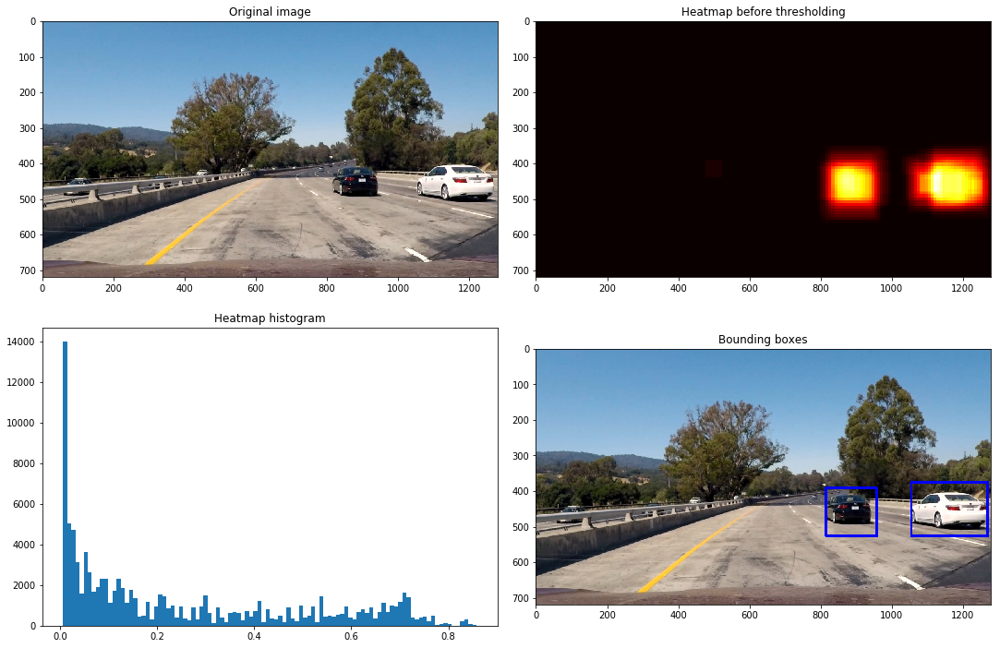

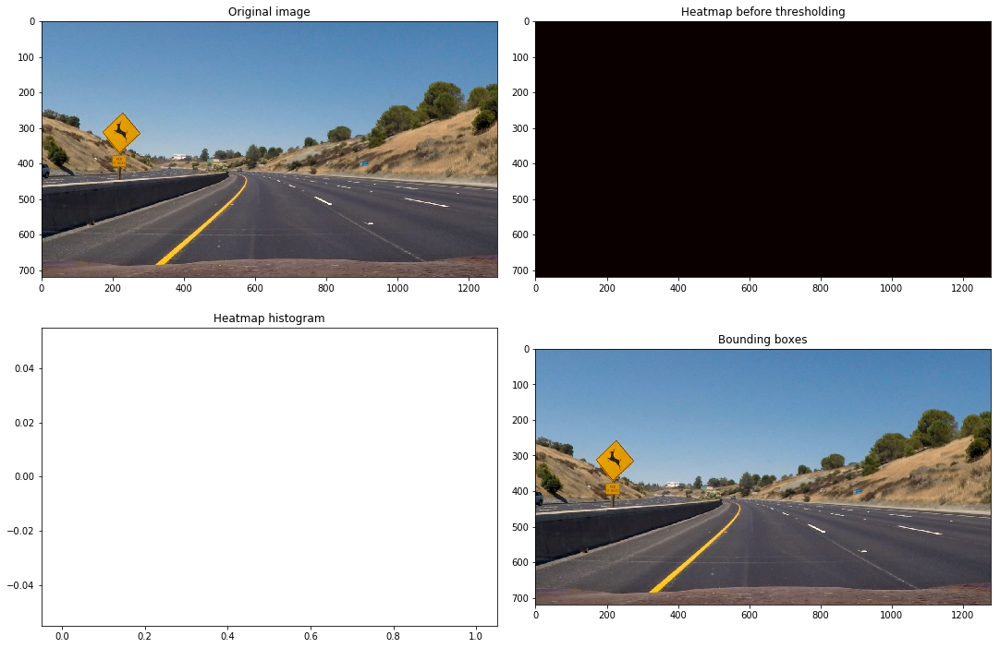

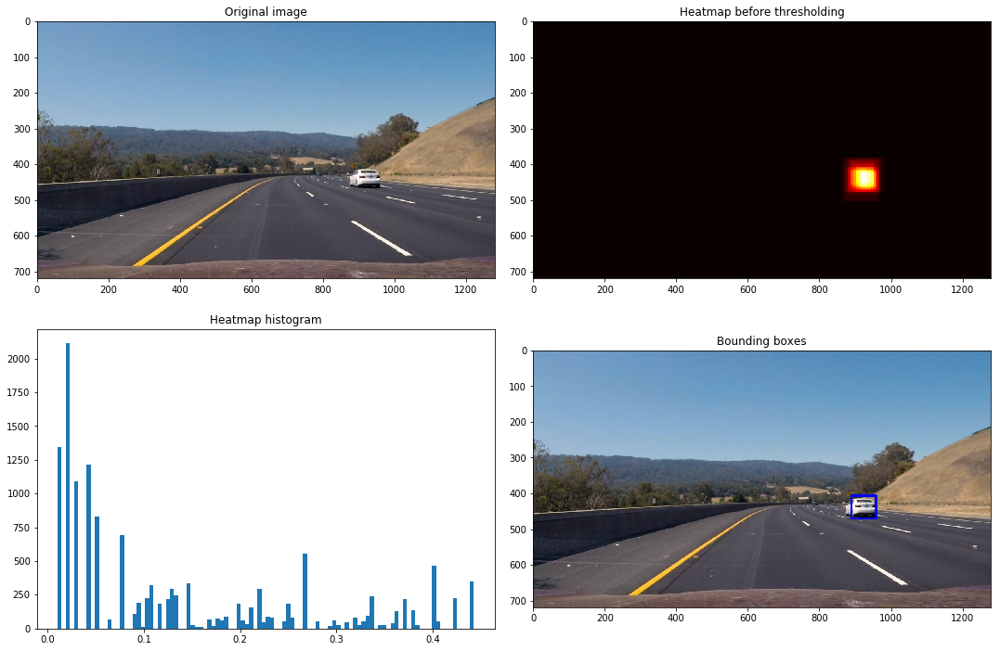

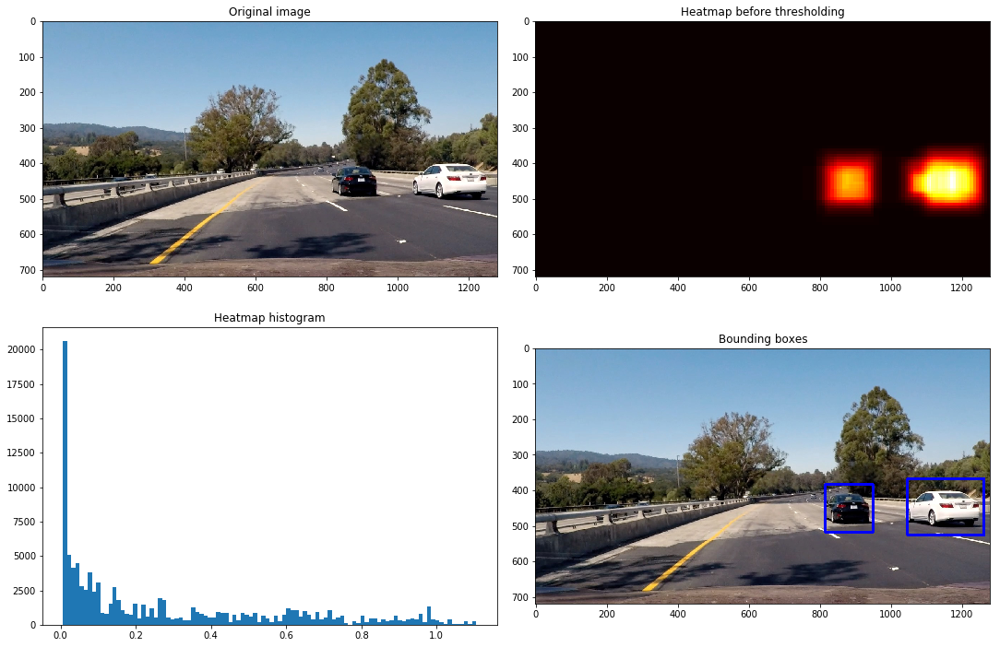

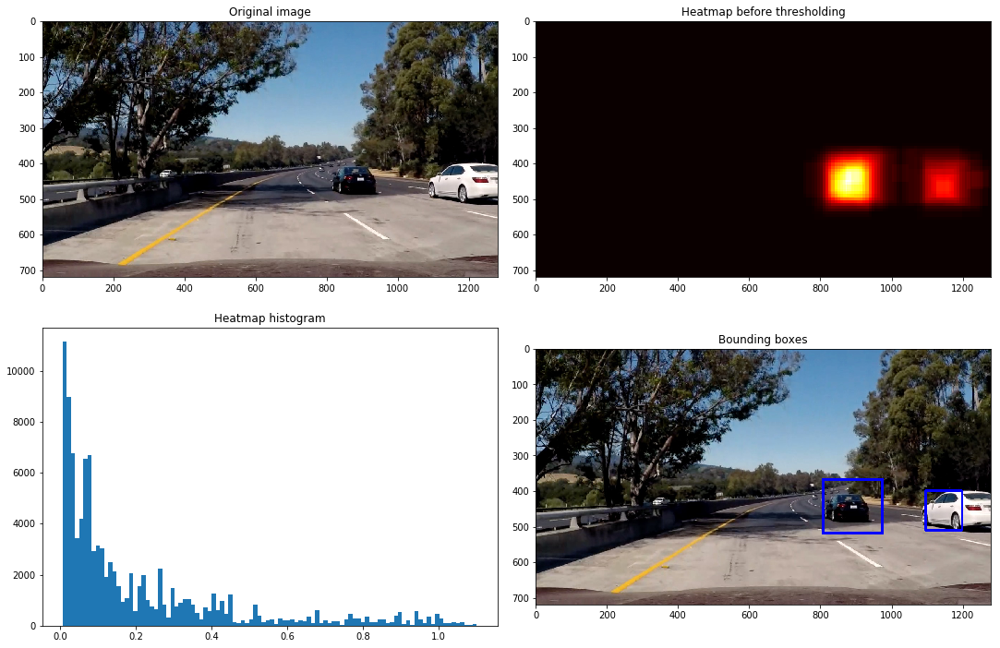

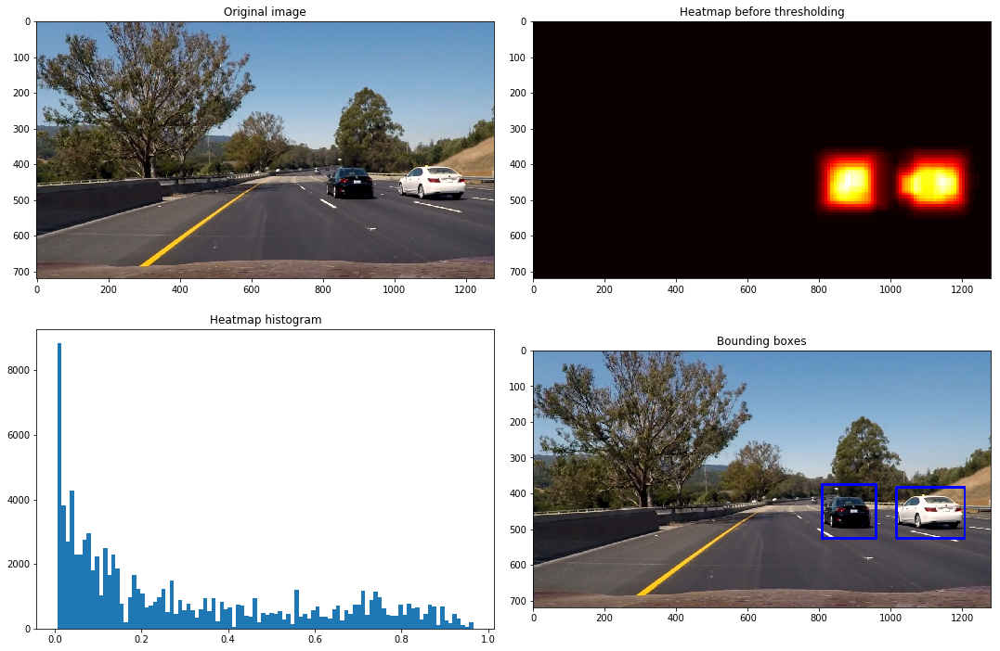

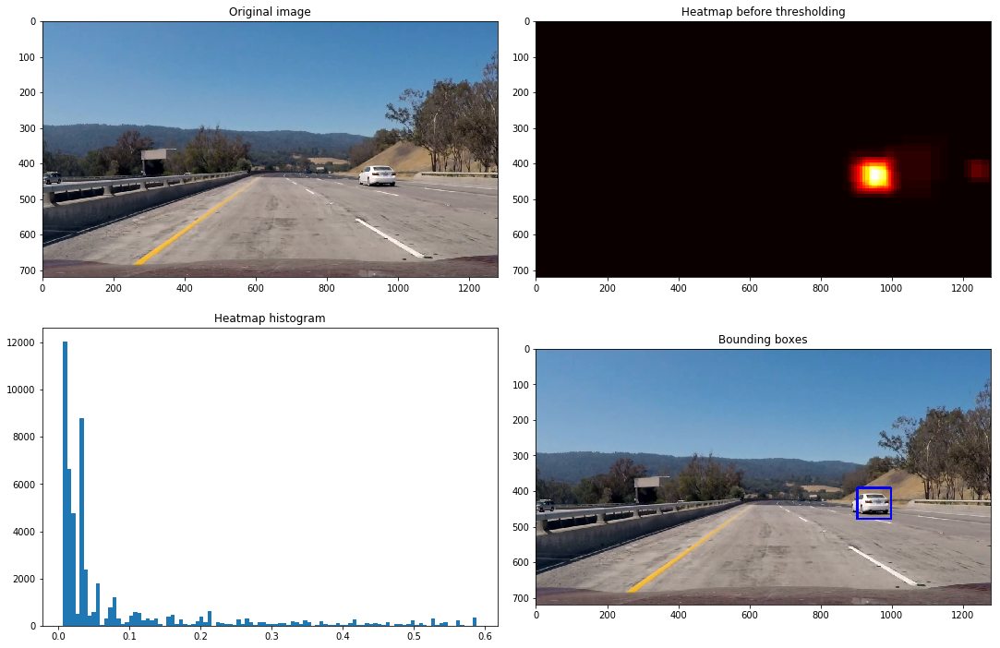

In [5]:
for img, good_windows in zip(images, img_good_windows):
    heatmap = get_heatmap(img, good_windows)
    
    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    fig.tight_layout()
    axs[0, 0].imshow(img)
    axs[0, 0].set_title("Original image")
    axs[0, 1].imshow(heatmap, cmap="hot")
    axs[0, 1].set_title("Heatmap before thresholding")
    
    heatmap_ravel = heatmap.ravel()
    axs[1, 0].hist( heatmap_ravel[heatmap_ravel > 0.], bins=100)
    axs[1, 0].set_title("Heatmap histogram")
    
    heatmap[heatmap < 0.2] = 0
    labels = label(heatmap)
    draw_img = draw_labeled_bboxes(img, labels)
    
    axs[1, 1].imshow(draw_img, cmap="hot")
    axs[1, 1].set_title("Bounding boxes")